## The Kuramoto-Sivashinsky equation

The Kuramoto-Sivashinsky (KS) equation is a non-linear partial differential equation with 1 spatial and 1 temporal dimension. The *integral form* reads

$$u_t + u_{xx} + u_{xxxx} + \frac{1}{2} u_x^2 = 0,$$
where we assume a finite spatial domain $x \in [0, L]$ with periodic boundary conditions and a positive time parameter $t \in [0, \infty)$.
Another form, the *derivative form*, can be obtained by differentiating with respect to $x$ and substituting $v = u_x$

$$v_t + v_{xx} + v_{xxxx} + v v_x = 0 .$$

### Numerical solution: derivative form
First, let us recast the KS equation in derivative form to

$$v_t = L(v) + N(v),$$

defining the linear part $L(v) = -v_{xx} - v_{xxxx}$ and non-linear part $N(v) = -v v_x$.
The time variable is discretized in real domain $v^n(x) = v(x, n \Delta t)$ along small time-steps $\Delta t \ll 1$.
The spatial variable is discretized via a discrete Fourier transform

$$\tilde{v}^n(k) = \sum_{m=0}^{N-1} v^n(m \Delta x) e^{-i \frac{2\pi k}{L} m\Delta x}, \quad
v^n(m \Delta x) = \frac{1}{N} \sum_{k=0}^{N-1} \tilde{v}^n(k) e^{i \frac{2\pi k}{L} m\Delta x}$$

on small spatial increments $\Delta x = \frac{L}{N-1} \ll 1$ and the real wavenumbers $\alpha_k = \frac{2\pi k}{L}$.
The linear part will be numerically solved using [Crank-Nicolson time-stepping](https://en.wikipedia.org/wiki/Crank%E2%80%93Nicolson_method) and the non-linear terms by the [Adams-Bashforth 2-step method](https://en.wikipedia.org/wiki/Linear_multistep_method#Adams%E2%80%93Bashforth_methods). Together, this is abbreviated by CNAB2. In short, the Crank-Nicolson method integrates some general PDE

$$\frac{\partial y}{\partial t} = F(y, x, t, \frac{\partial y}{\partial x}, \dots) \quad \longrightarrow \quad
\frac{y^{n+1} - y^n}{\Delta t} = \frac{1}{2} [F^{n+1} + F^n],$$

whereas 2-step Adams-Bashforth integrates (non-linear) ODEs

$$\frac{\mathrm{d} y}{\mathrm{d} t} = f(t, y) \quad \longrightarrow \quad
y^{n+1} = y^n + \Delta t \left[\frac{3}{2} f^n - \frac{1}{2} f^{n-1}\right].$$

Applied to the KS equation in derivative form, we obtain

$$\frac{v^{n+1} - v^n}{\Delta t} = \frac{1}{2} L(v^{n+1} + v^n) + \frac{3}{2} N(v^n) - \frac{1}{2} N(v^{n-1}) \\
(1 - \frac{\Delta t}{2} L) v^{n+1} = (1 + \frac{\Delta t}{2} L) v^n + \frac{3\Delta t}{2} N(v^n) - \frac{\Delta t}{2} N(v^{n-1}).$$

Finally, we go to Fourier space so that $v^n \to \bm{v}^n$ now is a vector of Fourier coefficients and

$$L(v) \to \mathrm{diag}(\alpha_k^2 - \alpha_k^4)_{k=0,\dots,N-1} \bm{v}\\
N(v) = -\frac{1}{2} \frac{\mathrm{d}}{\mathrm{d}x} v^2 \to
\frac{i}{2} \mathrm{diag}(\alpha_k)_k \mathcal{F}\{v^2\}$$

become matrices (in particular $L$ is diagonal). What's left to solve is a linear algebra equation that is just iterated to obtain the (approximative) time evolution of the KS equation:

$$\bm{\tilde{v}}^{n+1} = B \left[ A \bm{\tilde{v}}^n + \frac{3\Delta t}{2} \bm{N}^n - \frac{\Delta t}{2} \bm{N}^{n-1} \right],\quad 
A = I + \frac{\Delta t}{2} L,\quad B = \left[ I - \frac{\Delta t}{2} L \right]^{-1}.$$

### Implementation in Julia
Let us first code a "naive" version of this CNAB2 stepping which employs no particular performance optimizations.

In [1]:
using FFTW
using Plots; gr()
theme(:lime)
using GLMakie
set_theme!(theme_black())
using Makie: PriorityObservable

In [2]:
function ksIntegrateSlow(u, Lx, dt, Nt, nplot)
    Nx = length(u)
    kx = vcat(0:Nx/2-1, 0, -Nx/2+1:-1) # integer wavenumbers in weird ordering
    alpha = 2*pi/Lx * kx
    D = 1im * alpha
    L = alpha.^2 - alpha.^4
    G = -0.5 * D
    nsave = round(Int64, Nt/nplot)+1 # total number of saved time steps

    x = Lx/Nx * collect(0:Nx-1)
    t = dt*nplot * collect(0:nsave-1)
    U = zeros(Float64, nsave, Nx)

    # convenience variables
    dt2 = dt/2
    dt32 = 3*dt/2
    A = ones(Nx) + dt2*L
    B = (ones(Nx) - dt2*L).^-1
    
    Nn = G .* fft(u.*u)
    Nn1 = Nn
    U[1,:] = u # save boundary condition
    u = fft(u)
    counter = 2

    for n = 0:Nt-1
        Nn1 = Nn
        Nn = G .* fft(real(ifft(u)).^2)
        u = B .* (A .* u + dt32*Nn - dt2*Nn1)

        if mod(n, nplot) == 0
            U[counter,:] = real(ifft(u))
            counter += 1
        end
    end
    U, t, x
end

ksIntegrateSlow (generic function with 1 method)

The improved version utilizes:
- *in-place planned* FFTs: *in-place* means that the FFT modifies the input array which avoid allocating memory; *planned* FFTs are used if several FFTs of the same size are performed so that "FFT plans" can be pre-computed (the FFT operation then is a multiplication `plan*array`)
- `@inbounds` macro: tells the compiler to not check whether array indices are actually in bound
- `@fastmath` macro: floating-point optimizations for real numbers (might lead to differences in the numerical results!)

In [3]:
function ksIntegrateFast(u0, Lx, dt, Nt, nplot)
    Nx = length(u0)
    # integer wavenumbers in weird ordering
    # incorporates PBC (Nx/2-1 to 0, and circular frequency shift)
    kx = vcat(0:Nx/2-1, 0, -Nx/2+1:-1) 
    alpha = 2*pi/Lx * kx
    D = 1im * alpha
    L = alpha.^2 - alpha.^4
    G = -0.5 * D
    nsave = round(Int64, Nt/nplot)+1 # total number of saved time steps

    x = Lx/Nx * collect(0:Nx-1)
    t = dt*nplot * collect(0:nsave-1)
    U = zeros(Float64, nsave, Nx)
    U[1,:] = u0 # save boundary condition
    u = (1 + 0im) * u0

    # convenience variables
    dt2 = dt/2
    dt32 = 3*dt/2
    A = ones(Nx) + dt2*L
    B = (ones(Nx) - dt2*L).^-1
    
    # compute in-place planned FFTs
    FFT! = plan_fft!(u, flags=FFTW.ESTIMATE)
    IFFT! = plan_ifft!(u, flags=FFTW.ESTIMATE)

    # in Fourier domain
    Nn = G .* fft(u.^2)
    Nn1 = copy(Nn)
    FFT! * u
    counter = 2

    for n = 0:Nt-1
        # compute Nn = G .* fft(real(ifft(u)).^2) inbounds with fastmath
        for i = 1:length(Nn)
            @inbounds Nn1[i] = Nn[i]
            @inbounds Nn[i] = u[i]
        end

        IFFT! * Nn

        for i = 1:length(Nn)
            @fastmath @inbounds Nn[i] = Nn[i] * Nn[i]
        end
        
        FFT! * Nn
        
        for i = 1:length(Nn)
            @fastmath @inbounds Nn[i] = G[i] * Nn[i]
        end

        # compute u = B .* (A .* u + dt32*Nn - dt2*Nn1) inbounds with fastmath
        for i = 1:length(u)
            @fastmath @inbounds u[i] = B[i] * (A[i] * u[i] + dt32*Nn[i] - dt2*Nn1[i])
        end

        # save every nplot-th solution to returned array u
        if mod(n, nplot) == 0
            U[counter,:] = real(ifft(u))
            counter += 1
        end
    end
    U, t, x
end

ksIntegrateFast (generic function with 1 method)

### Plotting in Julia
For simple, non-interactive plots we use the `gr()` backend of the `Plots` module. This is fast (of course plots need to pre-compile first) and straight-forward to use. Simple animations can be created using the `@gif` macro around a for-loop.

For more involved and interactive/animated plotting we will be using the `GLMakie` module (which uses OpenGL to compute plots the GPU). This also brings nice layout/UI capabilities with it. We can write animations to an .mp4 file (works out of the box!) or actually run the animation live in an unbounded loop.

  0.308028 seconds (182.89 k allocations: 746.522 MiB, 13.68% gc time)
  0.085402 seconds (17.02 k allocations: 33.508 MiB)
Uslow = Ufast: true

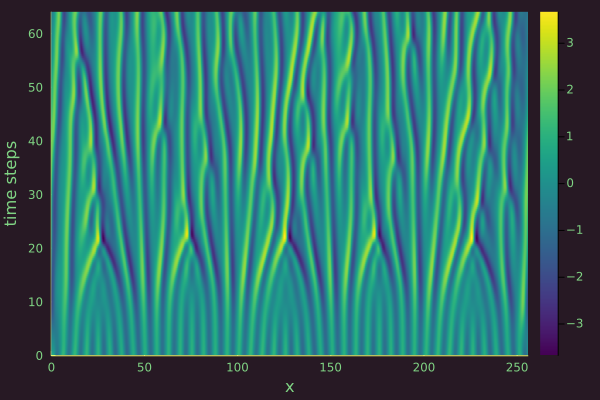

In [6]:
# run test and plot heatmap
Lx = 256
Nx = 2048
dt = 1/32
nplot = 4
Nt = 2048

x = Lx/Nx * collect(1:Nx)
u0 = cos.(x) .+ 0.1*cos.(x/16) .* (1 .+ 2*sin.(x/16))
@time Uslow, tslow, xslow = ksIntegrateSlow(u0, Lx, dt, Nt, nplot);
@time Ufast, tfast, xfast = ksIntegrateFast(u0, Lx, dt, Nt, nplot);
# check whether fast and slow integrator produce same results
print("Uslow = Ufast: ", isapprox(Uslow, Ufast))
Plots.heatmap(xfast, tfast, Ufast, xlabel = "x", ylabel = "time steps")

In [10]:
# animate KS cross section in Plots.jl
start = 100
num = 100

@gif for i = 1:num
    plot(x, U[i+start,:], leg = false,
        xlims = (x[begin], x[end]), ylims = (-2.5, 2.5),
        xlabel = "x", ylabel = "time steps")
end
; # omit semicolon to show gif below

┌ Info: Saved animation to 
│   fn = /tmp/jl_YUqdnc.gif
└ @ Plots /home/paul/.julia/packages/Plots/8K4be/src/animation.jl:114


In [24]:
# animate KS cross section in Makie.jl
time = Observable(1)

y = @lift(U[$time, :])
fig = Figure()
ax = Axis(fig[1, 1], xlabel = "x", ylabel = "U(x)")
lines!(ax, x, y, color = :springgreen)
GLMakie.xlims!(ax, x[begin], x[end]) # use GLMakie. to avoid double-naming with Plots.jl
GLMakie.ylims!(ax, -3.0, 3.0)

framerate = 30
timestamps = 1:length(t)

record(fig, "cross_section_anim.mp4", timestamps; framerate = framerate) do t
    time[] = t
end

"cross_section_anim.mp4"

In [50]:
# live animating the heatmap
# plot parameters
fps = 30
fig = Figure()
ax = Axis(fig[1, 1])
hidedecorations!(ax)

# KS parameters
Lx = 32
Nx = 1024
dt = 1/16
Nt = 1600 # number of time steps within figure
nplot = 8
nsave = round(Int64, Nt/nplot)+1 # total number of saved time steps

x = Lx/Nx * collect(1:Nx)
t = dt*nplot * collect(0:nsave-1)
u0 = cos.(x) .+ 0.1*cos.(x/16) .* (1 .+ 2*sin.(x/16))
# u0 = rand(Nx) # uniform distribution with u0 in [0,1]
U = zeros(Float64, nsave, Nx)
U[1,:] = u0 # save boundary condition
u = fft(u0) # go to Fourier domain during time stepping

# CNAB2 variables
kx = vcat(0:Nx/2-1, 0, -Nx/2+1:-1) # integer wavenumbers in weird ordering
# kx = collect(0:Nx-1) # integer wavenumbers in stable ordering
alpha = 2*pi/Lx * kx
D = 1im * alpha
L = alpha.^2 - alpha.^4
G = -0.5 * D

# convenience variables
dt2 = dt/2
dt32 = 3*dt/2
A = ones(Nx) + dt2*L
B = (ones(Nx) - dt2*L).^-1
Nn = G .* fft(u0.*u0)
Nn1 = Nn
counter = 2

# initial time stepping
for n = 0:Nt-1
    Nn1 = Nn
    Nn = G .* fft(real(ifft(u)).^2)
    u = B .* (A .* u + dt32*Nn - dt2*Nn1)

    if mod(n, nplot) == 0
        U[counter,:] = real(ifft(u))
        counter += 1
    end
end

# live time stepping and plotting
hm = GLMakie.heatmap!(t, x, U,
    fxaa = true, inspectable = false,
    colorrange = (-maximum(U), maximum(U)))
GLMakie.display(fig)
while events(fig).window_open[]
    for n = 0:nplot-1
        Nn1 = Nn
        Nn = G .* fft(real(ifft(u)).^2)
        u = B .* (A .* u + dt32*Nn - dt2*Nn1)

        if mod(n, nplot) == 0
            # push through new data
            U = vcat(U[begin+1:end,:], real(ifft(u))')
            t = vcat(t[begin+1:end], [counter*dt*nplot])
            counter += 1
        end
    end
    # hm[1] = t # Why does this not work?
    hm[3] = U
    sleep(1/fps)
end

### Audio in Julia
The most elementary audio module we'll use is `PortAudio`. It manages the annoying audio backend stuff for us, so that we can directly compute an audio buffer and write it to the sound card. The standard ouput stream can be set up via `stream = PortAudioStream(0, 2; samplerate=sample_rate)` and closed with `close(stream)`. What we call the "audio buffer" is actually just an array where we play `sample_rate` elements per second; so for the standard setup with an sample rate of `sample_rate=44100` samples per second, the stream plays 44100 audio buffer array elements per second. To write the buffer (meaning, "playing" the audio buffer) to the sound card, we use `write(stream, buf)`.

In [226]:
using PortAudio
# open output stream
sample_rate = Float64(44100)
stream = PortAudioStream(0, 2; samplerate=sample_rate)
# close(stream)

0

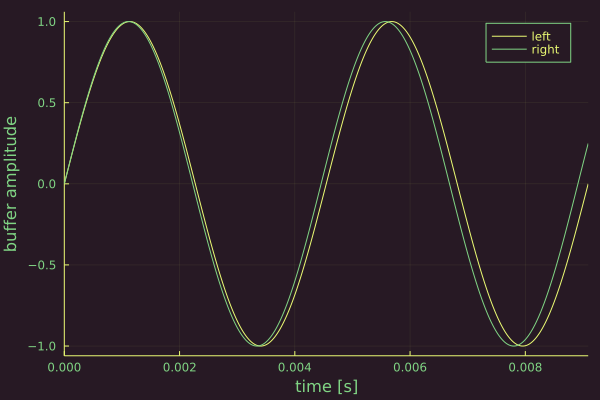

In [225]:
# create a simple sine wave audio buffer
duration = 2 # in seconds
time_steps = collect(0:duration*sample_rate-1) / sample_rate # in seconds
freq = 220 # in Hertz

buf_l = sin.(2pi * time_steps * freq)
buf_r = sin.(1.02 * 2pi * time_steps * freq)
write(stream, hcat(buf_l, buf_r))
Plots.plot(time_steps, buf_l, label = "left")
Plots.plot!(time_steps, buf_r, label = "right")
Plots.xlabel!("time [s]")
Plots.ylabel!("buffer amplitude")
Plots.xlims!(0.0, 2/freq)

One issue is to (continuously or discretely) vary the sine frequency without getting audio clicks and pops. One way to achieve this is by continously varying the actual frequency in the sine function with each sample. This requires an `time_steps` vector as above, but also a `freq_steps` vector which has the same length, and in the easiest case, just ranges linearly from some start- to some stop-frequency. This is computationally more expensive and also requires allocation of an extra array.

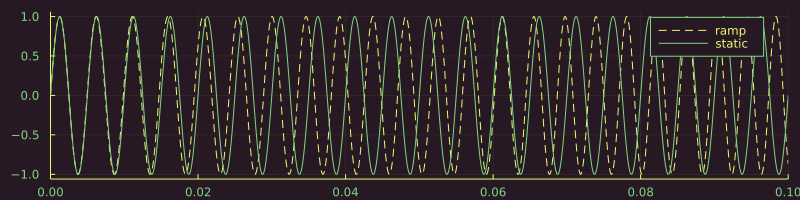

In [8]:
# create frequency ramp audio buffer without clicks
duration = 3
start_freq, stop_freq = 200, 1000
time_steps = collect(0:duration*sample_rate-1) / sample_rate
freq_steps = collect(range(start_freq, stop_freq, Int(duration*sample_rate)))

buf_static = sin.(2pi * time_steps * start_freq)
buf_ramp = sin.(2pi * time_steps .* freq_steps)
write(stream, buf_ramp)

Plots.plot(time_steps, buf_ramp, line = :dash, size = (800, 200), label = "ramp")
Plots.plot!(time_steps, buf_static, label = "static")
Plots.xlims!(0.0, 20/start_freq)

Another way - the cheaper way - to do avoid clicks when changing pitch is by handing over phase information between the sine waves with different frequencies, to enable a sine with higher frequency to start playing at the phase at which the sine with lower frequency stopped playing.

In [9]:
# create sample-and-hold-type buffer with random sine frequencies
num = 20
num_time = 0.25
rand_freqs = 200 .+ 500 * rand(num)

len = Int(num_time * sample_rate)
buf = zeros(Float64, num * len)
last_phase = 0.0
for i in 1:num
    buf[1+(i-1)*len:i*len] = sin.(last_phase .+ 2pi * (0:num_time*sample_rate-1) * rand_freqs[i] / sample_rate)
    last_phase = (last_phase + 2pi * (num_time*sample_rate) * rand_freqs[i] / sample_rate) % 2pi
end
write(stream, buf)

220500

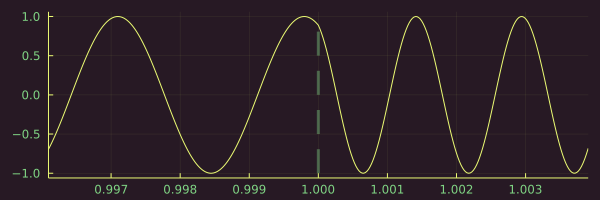

In [11]:
time_steps = collect(0:length(buf)-1) / sample_rate
eps = num_time/64
vert = 4*num_time
Plots.plot(time_steps, buf, leg = false, size = (600, 200))
Plots.plot!([vert, vert], [-1.0, 1.0], line = :dash, width = 3, alpha = 0.4)
Plots.xlims!(vert-eps, vert+eps)

To convert the actual `U[t,x]` data to sound, we could take the Fourier spectrum of the space domain at some time step to obtain relative sine amplitudes from the Fourier coefficients. The array indices will be mapped onto actual audio frequencies in the 20Hz-20kHz domain. (Of course this mapping can be varied for interesting results.) One practical way to do this is by padding out the Fourier spectrum `fft(U[t,:])` with zeros such that the length of the array corresponds to `time*sample_rate`, where `time` is the small time duration for which each time step is played. Then an inverse FFT is applied to obtain a real-numbered audio buffer.

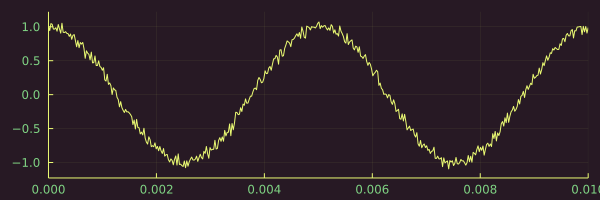

In [25]:
# create test Fourier spectrum and transform to audio buffer
time = 1.0
freq_idx = 200
norm = Int(time * sample_rate)
u = zeros(Float64, norm)
u[freq_idx] = 1.0 * norm
u_noise = randn(norm)
buf = real(ifft(u) .+ 15.0*ifft(u_noise))
write(stream, buf)

time_steps = collect(0:length(buf)-1) / sample_rate
Plots.plot(time_steps, buf, leg = false, size = (600, 200))
Plots.xlims!(0.0, 2/freq_idx)

In [138]:
# translate U[t,x] cross section to audio buffer via FFT
# KS parameters
Lx = 128
Nx = 512
dt = 1/8
nplot = 4
Nt = 1200
slice = 100 # cross section index

x = Lx/Nx * collect(1:Nx)
u0 = cos.(x) .+ 0.1*cos.(x/16) .* (1 .+ 2*sin.(x/16))
U, t, x = ksIntegrateFast(u0, Lx, dt, Nt, nplot)
U_norm = U ./ maximum(abs.(U)) # normalize solution
# Plots.plot(x, U_norm[slice, :], leg = false)

# audio parameters
duration = 1.0
buf_size = Int(duration * sample_rate)
start_freq = 100
spectrum = vcat(zeros(Float64, start_freq-1), U_norm[slice, :], 
    zeros(Float64, buf_size - (Nx+start_freq-1)));

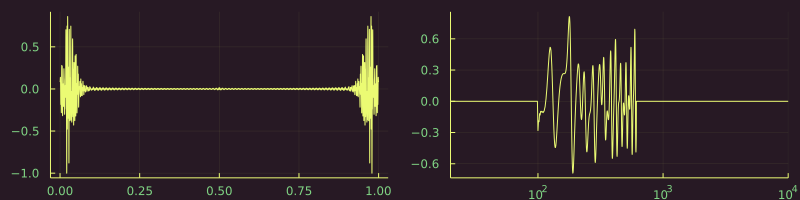

In [136]:
# audio buffer
buf = real(ifft(spectrum))
buf_norm = buf / maximum(abs.(buf))
# write audio buffer
write(stream, buf_norm);

# plots
p1 = Plots.plot(collect(1:buf_size)/sample_rate, buf_norm, leg = false)
p2 = Plots.plot(1:buf_size, spectrum, leg = false, xscale = :log)
Plots.xlims!(20, 10000)
# Plots.xticks!(1:100:2048, string.(1:100:2048))
Plots.plot(p1, p2, size = (800, 200))

The previous way to generate audio produces generally transient sounds. What would be more (artistically) useful is the a translation of the frequency spectrum to constant sine stacks. Adjacent cross sections `U[t,:]` would then continously "morph" into each other.

So what we need is a function that takes an input spectrum and returns a sine stack where the amplitudes of different frequencies are attenuated according to `U[t,x]` (and maybe some extra mapping).

In [181]:
# translate U[t,:] to audio buffer via sine stack
function getSineStack(u::Vector, freqs::Vector, amp_mapping::Function,
        last_phases::Vector, sample_rate::Number, grain_time::Number)

    buf_size = Int(grain_time * sample_rate)
    buf = zeros(Float64, buf_size)
    for i = 1:length(freqs)
        buf = buf .+ amp_mapping(u[i]) .*
            sin.(last_phases[i] .+ 2pi * (0:buf_size-1) * freqs[i] / sample_rate)
        last_phases[i] = (last_phases[i] + 2pi * buf_size * freqs[i] / sample_rate) % 2pi
    end
    buf = buf / maximum(buf)
    buf, last_phases
end

getSineStack (generic function with 1 method)

In [210]:
# KS parameters
Lx = 64
Nx = 64
dt = 1/16
nplot = 4
Nt = 1200
slice = 60 # cross section index

x = Lx/Nx * collect(1:Nx)
u0 = cos.(x) .+ 0.1*cos.(x/16) .* (1 .+ 2*sin.(x/16))
U, t, x = ksIntegrateFast(u0, Lx, dt, Nt, nplot)
U_norm = U ./ maximum(abs.(U)) # normalize solution

# U_test = zeros(Float64, Nx)
# U_test[50] = 0.5
# U_test[100] = 0.1
freqs = collect(range(200, 400, Nx))
grain_time = 4.0
am = x -> x^6
buf, last_phases = sine_stack = getSineStack(
    U_norm[slice, :], freqs, am, zeros(Float64, Nx), sample_rate, grain_time)
write(stream, buf);